In [1]:
# %%
import os
import tensorflow as tf
from tensorflow.keras.layers import Input, Conv2D, Conv2DTranspose, BatchNormalization, Activation, MaxPooling2D, UpSampling2D, Concatenate
from tensorflow.keras.models import Model
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.losses import CategoricalCrossentropy
from tensorflow.keras import backend as K
from tensorflow.keras.callbacks import EarlyStopping, ReduceLROnPlateau
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from sklearn.model_selection import train_test_split
import numpy as np
import cv2
from glob import glob
import matplotlib.pyplot as plt

os.environ["TF_CPP_MIN_LOG_LEVEL"] = "2"


2024-12-16 01:32:42.481027: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:485] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-12-16 01:32:42.504242: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:8454] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-12-16 01:32:42.510264: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1452] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2024-12-16 01:32:42.535333: I tensorflow/core/platform/cpu_feature_guard.cc:210] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2024-12-16 01:32:43.463567: W tensorflow/compiler/tf2

In [2]:
# %%
def conv_block(inputs, filters):
    x = Conv2D(filters, (3, 3), padding="same")(inputs)
    x = BatchNormalization()(x)
    x = Activation("relu")(x)

    x = Conv2D(filters, (3, 3), padding="same")(x)
    x = BatchNormalization()(x)
    x = Activation("relu")(x)
    return x

def encoder_block(inputs, filters):
    x = conv_block(inputs, filters)
    p = MaxPooling2D((2, 2))(x)
    return x, p

def decoder_block(inputs, skip, filters):
    x = UpSampling2D((2, 2))(inputs)
    x = Concatenate()([x, skip])
    x = conv_block(x, filters)
    return x

def build_unet(input_shape=(256, 256, 3), num_classes=4):
    inputs = Input(input_shape)

    # Encoder
    s1, p1 = encoder_block(inputs, 64)
    s2, p2 = encoder_block(p1, 128)
    s3, p3 = encoder_block(p2, 256)
    s4, p4 = encoder_block(p3, 512)

    # Bridge
    b = conv_block(p4, 1024)

    # Decoder
    d1 = decoder_block(b, s4, 512)
    d2 = decoder_block(d1, s3, 256)
    d3 = decoder_block(d2, s2, 128)
    d4 = decoder_block(d3, s1, 64)

    # Output
    outputs = Conv2D(num_classes, (1, 1), padding="same", activation="softmax")(d4)

    model = Model(inputs, outputs, name="U-Net")
    return model


In [3]:
# %%
def remap_mask_with_ranges(mask):
    remapped_mask = np.zeros_like(mask)

    background_range = (0, 50)       # Background
    gray_range = (70, 150)           # Putih keabu-abuan
    white_gray_range = (170, 230)    # Putih abu-abu
    white_range = (231, 255)         # Putih terang

    remapped_mask[(mask >= background_range[0]) & (mask <= background_range[1])] = 0
    remapped_mask[(mask >= gray_range[0]) & (mask <= gray_range[1])] = 1
    remapped_mask[(mask >= white_gray_range[0]) & (mask <= white_gray_range[1])] = 2
    remapped_mask[(mask >= white_range[0]) & (mask <= white_range[1])] = 3

    return remapped_mask

def preprocess_data(image_filenames, mask_filenames, target_size=(256, 256), num_classes=4):
    images, masks = [], []
    for img_path, mask_path in zip(image_filenames, mask_filenames):
        img = cv2.imread(img_path)
        if img is None:
            print(f"Warning: Unable to read image {img_path}. Skipping.")
            continue
        img = cv2.resize(img, target_size) / 255.0

        mask = cv2.imread(mask_path, cv2.IMREAD_GRAYSCALE)
        if mask is None:
            print(f"Warning: Unable to read mask {mask_path}. Skipping.")
            continue
        mask = remap_mask_with_ranges(mask)
        mask = cv2.resize(mask, target_size, interpolation=cv2.INTER_NEAREST)
        mask = tf.keras.utils.to_categorical(mask, num_classes=num_classes)

        images.append(img)
        masks.append(mask)

    return np.array(images), np.array(masks)


In [4]:
# %%
def mean_iou_custom(y_true, y_pred, num_classes=4):
    y_true = tf.argmax(y_true, axis=-1)
    y_pred = tf.argmax(y_pred, axis=-1)
    iou = 0.0
    for c in range(num_classes):
        y_true_c = K.cast(K.equal(y_true, c), 'float32')
        y_pred_c = K.cast(K.equal(y_pred, c), 'float32')
        intersection = K.sum(y_true_c * y_pred_c)
        union = K.sum(y_true_c) + K.sum(y_pred_c) - intersection
        iou += (intersection + K.epsilon()) / (union + K.epsilon())
    return iou / num_classes

def dice_coefficient(y_true, y_pred, num_classes=4):
    y_true = tf.argmax(y_true, axis=-1)
    y_pred = tf.argmax(y_pred, axis=-1)
    dice = 0.0
    for c in range(num_classes):
        y_true_c = K.cast(K.equal(y_true, c), 'float32')
        y_pred_c = K.cast(K.equal(y_pred, c), 'float32')
        intersection = K.sum(y_true_c * y_pred_c)
        denominator = K.sum(y_true_c) + K.sum(y_pred_c)
        dice += (2. * intersection + K.epsilon()) / (denominator + K.epsilon())
    return dice / num_classes


In [5]:
# %%
image_filenames = sorted(glob('/home/khroos/work/Unet-Brain-MRI-Segmentation-Tensorflow-Keras/Cardiac_MRI_Dataset/es_training/*'))     # Sesuaikan path dataset Anda
mask_filenames = sorted(glob('/home/khroos/work/Unet-Brain-MRI-Segmentation-Tensorflow-Keras/Cardiac_MRI_Dataset/es_training_gt/*'))       # Sesuaikan path dataset Anda

# Split dataset
image_train, image_val, mask_train, mask_val = train_test_split(
    image_filenames, mask_filenames, test_size=0.2, random_state=42
)

X_train, y_train = preprocess_data(image_train, mask_train)
X_val, y_val = preprocess_data(image_val, mask_val)


In [6]:
# %%
# Definisikan parameter augmentasi
data_gen_args = dict(
    horizontal_flip=True,
    vertical_flip=True,
    rotation_range=20,
    width_shift_range=0.1,
    height_shift_range=0.1,
    fill_mode='nearest'
)

seed = 42
batch_size = 4  # Sesuaikan dengan batch size terbaik Anda

image_datagen = ImageDataGenerator(**data_gen_args)
mask_datagen = ImageDataGenerator(**data_gen_args)

image_generator = image_datagen.flow(
    X_train, batch_size=batch_size, seed=seed
)

mask_generator = mask_datagen.flow(
    y_train, batch_size=batch_size, seed=seed
)

# Gabungkan generator image dan mask agar augmentasi sinkron
train_generator = zip(image_generator, mask_generator)


In [8]:
def combined_generator(image_gen, mask_gen):
    while True:
        X = next(image_gen)
        Y = next(mask_gen)
        yield X, Y


In [9]:
# %%
best_learning_rate = 0.001
best_optimizer = Adam(learning_rate=best_learning_rate)

unet_model = build_unet(input_shape=(256, 256, 3), num_classes=4)
unet_model.compile(
    optimizer=best_optimizer,
    loss=CategoricalCrossentropy(),
    metrics=["accuracy", mean_iou_custom, dice_coefficient]
)

callbacks = [
    EarlyStopping(monitor='val_mean_iou_custom', patience=10, restore_best_weights=True, mode='max'),
    ReduceLROnPlateau(monitor='val_mean_iou_custom', factor=0.2, patience=5, min_lr=1e-7, mode='max')
]

steps_per_epoch = len(X_train) // batch_size

train_generator = combined_generator(image_generator, mask_generator)

history = unet_model.fit(
    train_generator,
    steps_per_epoch=steps_per_epoch,
    validation_data=(X_val, y_val),
    epochs=50,
    callbacks=callbacks,
    verbose=1
)


Epoch 1/50


I0000 00:00:1734287648.529102   10876 service.cc:146] XLA service 0x7f9cd00020d0 initialized for platform CUDA (this does not guarantee that XLA will be used). Devices:
I0000 00:00:1734287648.529168   10876 service.cc:154]   StreamExecutor device (0): NVIDIA GeForce RTX 4070 Ti, Compute Capability 8.9
2024-12-16 01:34:08.785648: I tensorflow/compiler/mlir/tensorflow/utils/dump_mlir_util.cc:268] disabling MLIR crash reproducer, set env var `MLIR_CRASH_REPRODUCER_DIRECTORY` to enable.
2024-12-16 01:34:09.751518: I external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:531] Loaded cuDNN version 8907
2024-12-16 01:34:17.219090: E external/local_xla/xla/service/slow_operation_alarm.cc:65] Trying algorithm eng33{k2=2,k6=2,k13=1,k14=0,k22=0} for conv (f32[4,64,256,256]{3,2,1,0}, u8[0]{0}) custom-call(f32[4,192,256,256]{3,2,1,0}, f32[64,192,3,3]{3,2,1,0}, f32[64]{0}), window={size=3x3 pad=1_1x1_1}, dim_labels=bf01_oi01->bf01, custom_call_target="__cudnn$convBiasActivationForward", backend_con

  1/129 ━━━━━━━━━━━━━━━━━━━━ 1:48:14 51s/step - accuracy: 0.3128 - dice_coefficient: 0.1413 - loss: 1.5534 - mean_iou_custom: 0.0894

I0000 00:00:1734287692.045248   10876 device_compiler.h:188] Compiled cluster using XLA!  This line is logged at most once for the lifetime of the process.


129/129 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step - accuracy: 0.8954 - dice_coefficient: 0.2407 - loss: 0.4333 - mean_iou_custom: 0.2283

2024-12-16 01:35:12.924947: E external/local_xla/xla/service/slow_operation_alarm.cc:65] Trying algorithm eng33{k2=15,k6=0,k13=1,k14=0,k22=1} for conv (f32[32,64,256,256]{3,2,1,0}, u8[0]{0}) custom-call(f32[32,64,256,256]{3,2,1,0}, f32[64,64,3,3]{3,2,1,0}, f32[64]{0}), window={size=3x3 pad=1_1x1_1}, dim_labels=bf01_oi01->bf01, custom_call_target="__cudnn$convBiasActivationForward", backend_config={"operation_queue_id":"0","wait_on_operation_queues":[],"cudnn_conv_backend_config":{"conv_result_scale":1,"activation_mode":"kNone","side_input_scale":0,"leakyrelu_alpha":0},"force_earliest_schedule":false} is taking a while...
2024-12-16 01:35:15.102393: E external/local_xla/xla/service/slow_operation_alarm.cc:133] The operation took 3.177554242s
Trying algorithm eng33{k2=15,k6=0,k13=1,k14=0,k22=1} for conv (f32[32,64,256,256]{3,2,1,0}, u8[0]{0}) custom-call(f32[32,64,256,256]{3,2,1,0}, f32[64,64,3,3]{3,2,1,0}, f32[64]{0}), window={size=3x3 pad=1_1x1_1}, dim_labels=bf01_oi01->bf01, custom_ca

129/129 ━━━━━━━━━━━━━━━━━━━━ 141s 705ms/step - accuracy: 0.8958 - dice_coefficient: 0.2408 - loss: 0.4319 - mean_iou_custom: 0.2284 - val_accuracy: 0.9625 - val_dice_coefficient: 0.2457 - val_loss: 0.3997 - val_mean_iou_custom: 0.2416 - learning_rate: 0.0010
Epoch 2/50
129/129 ━━━━━━━━━━━━━━━━━━━━ 12s 91ms/step - accuracy: 0.9672 - dice_coefficient: 0.2613 - loss: 0.1352 - mean_iou_custom: 0.2509 - val_accuracy: 0.5473 - val_dice_coefficient: 0.2330 - val_loss: 1.3240 - val_mean_iou_custom: 0.1702 - learning_rate: 0.0010
Epoch 3/50
129/129 ━━━━━━━━━━━━━━━━━━━━ 11s 83ms/step - accuracy: 0.9694 - dice_coefficient: 0.3976 - loss: 0.1054 - mean_iou_custom: 0.3380 - val_accuracy: 0.6073 - val_dice_coefficient: 0.2498 - val_loss: 0.8790 - val_mean_iou_custom: 0.1868 - learning_rate: 0.0010
Epoch 4/50
129/129 ━━━━━━━━━━━━━━━━━━━━ 11s 86ms/step - accuracy: 0.9721 - dice_coefficient: 0.4728 - loss: 0.0945 - mean_iou_custom: 0.4018 - val_accuracy: 0.9071 - val_dice_coefficient: 0.3580 - val_loss

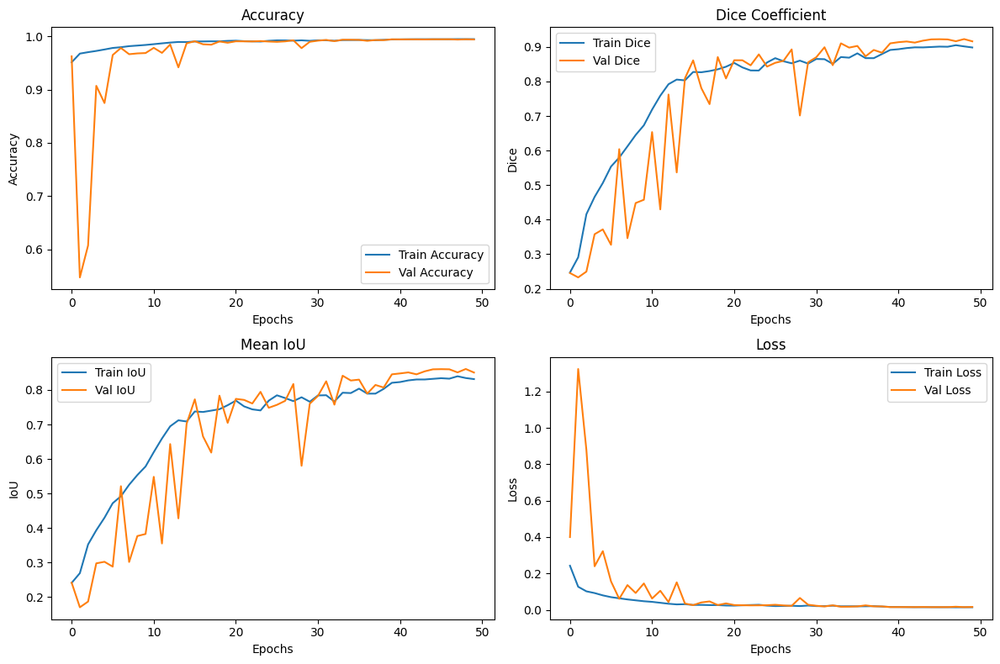

In [10]:
# %%
history_dict = history.history

plt.figure(figsize=(12, 8))

plt.subplot(2, 2, 1)
plt.plot(history_dict['accuracy'], label='Train Accuracy')
plt.plot(history_dict['val_accuracy'], label='Val Accuracy')
plt.title('Accuracy')
plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.legend()

plt.subplot(2, 2, 2)
plt.plot(history_dict['dice_coefficient'], label='Train Dice')
plt.plot(history_dict['val_dice_coefficient'], label='Val Dice')
plt.title('Dice Coefficient')
plt.xlabel('Epochs')
plt.ylabel('Dice')
plt.legend()

plt.subplot(2, 2, 3)
plt.plot(history_dict['mean_iou_custom'], label='Train IoU')
plt.plot(history_dict['val_mean_iou_custom'], label='Val IoU')
plt.title('Mean IoU')
plt.xlabel('Epochs')
plt.ylabel('IoU')
plt.legend()

plt.subplot(2, 2, 4)
plt.plot(history_dict['loss'], label='Train Loss')
plt.plot(history_dict['val_loss'], label='Val Loss')
plt.title('Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()

plt.tight_layout()
plt.show()


In [11]:
# %%
def calculate_metrics(y_true, y_pred, num_classes=4):
    iou_list = []
    dice_list = []

    for i in range(len(y_true)):
        true_mask = np.argmax(y_true[i], axis=-1)
        pred_mask = np.argmax(y_pred[i], axis=-1)

        for c in range(num_classes):
            true_c = (true_mask == c).astype(np.float32)
            pred_c = (pred_mask == c).astype(np.float32)

            intersection = np.sum(true_c * pred_c)
            union = np.sum(true_c) + np.sum(pred_c) - intersection
            iou = (intersection + 1e-6) / (union + 1e-6)
            iou_list.append(iou)

            dice = (2 * intersection + 1e-6) / (np.sum(true_c) + np.sum(pred_c) + 1e-6)
            dice_list.append(dice)

    mean_iou = np.mean(iou_list)
    mean_dice = np.mean(dice_list)

    return mean_iou, mean_dice

# Preprocess test data
image_filenames_test = sorted(glob('/home/khroos/work/Unet-Brain-MRI-Segmentation-Tensorflow-Keras/Cardiac_MRI_Dataset/es_testing/*'))    # Sesuaikan path dataset Anda
mask_filenames_test = sorted(glob('/home/khroos/work/Unet-Brain-MRI-Segmentation-Tensorflow-Keras/Cardiac_MRI_Dataset/es_testing_gt/*'))      # Sesuaikan path dataset Anda

X_test, y_test = preprocess_data(image_filenames_test, mask_filenames_test)

predictions_test = unet_model.predict(X_test)
mean_iou_test, mean_dice_test = calculate_metrics(y_test, predictions_test, num_classes=4)

print(f"Test Mean IoU: {mean_iou_test:.4f}")
print(f"Test Mean Dice: {mean_dice_test:.4f}")


7/8 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step

2024-12-16 01:45:42.529713: E external/local_xla/xla/service/slow_operation_alarm.cc:65] Trying algorithm eng0{} for conv (f32[20,64,256,256]{3,2,1,0}, u8[0]{0}) custom-call(f32[20,192,256,256]{3,2,1,0}, f32[64,192,3,3]{3,2,1,0}, f32[64]{0}), window={size=3x3 pad=1_1x1_1}, dim_labels=bf01_oi01->bf01, custom_call_target="__cudnn$convBiasActivationForward", backend_config={"operation_queue_id":"0","wait_on_operation_queues":[],"cudnn_conv_backend_config":{"conv_result_scale":1,"activation_mode":"kNone","side_input_scale":0,"leakyrelu_alpha":0},"force_earliest_schedule":false} is taking a while...
2024-12-16 01:45:44.527151: E external/local_xla/xla/service/slow_operation_alarm.cc:133] The operation took 2.997551151s
Trying algorithm eng0{} for conv (f32[20,64,256,256]{3,2,1,0}, u8[0]{0}) custom-call(f32[20,192,256,256]{3,2,1,0}, f32[64,192,3,3]{3,2,1,0}, f32[64]{0}), window={size=3x3 pad=1_1x1_1}, dim_labels=bf01_oi01->bf01, custom_call_target="__cudnn$convBiasActivationForward", backend

8/8 ━━━━━━━━━━━━━━━━━━━━ 15s 2s/step 
Test Mean IoU: 0.7208
Test Mean Dice: 0.7816


8/8 ━━━━━━━━━━━━━━━━━━━━ 1s 184ms/step


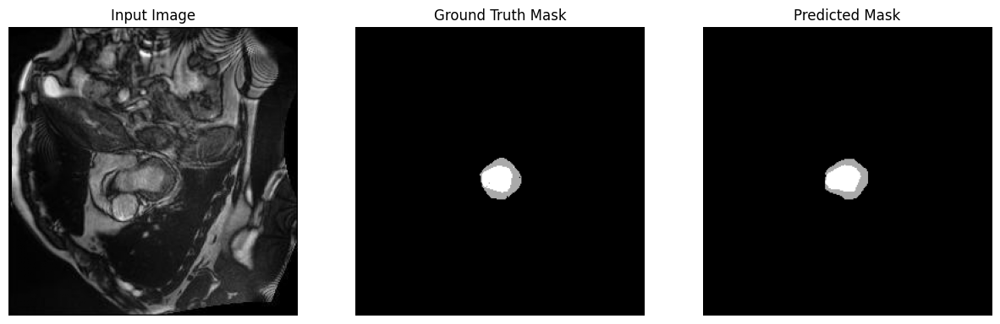

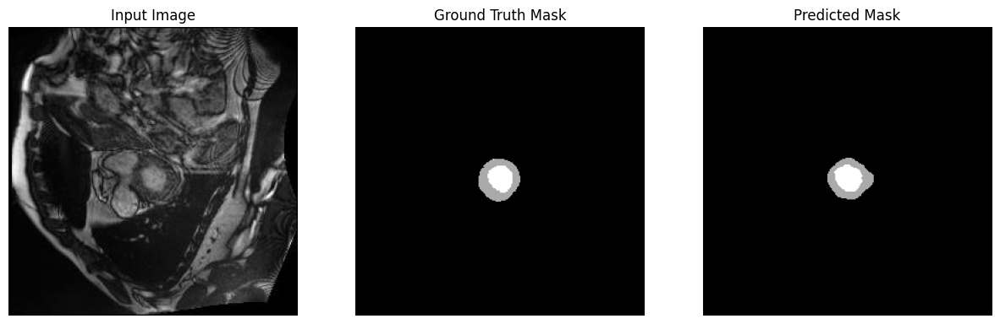

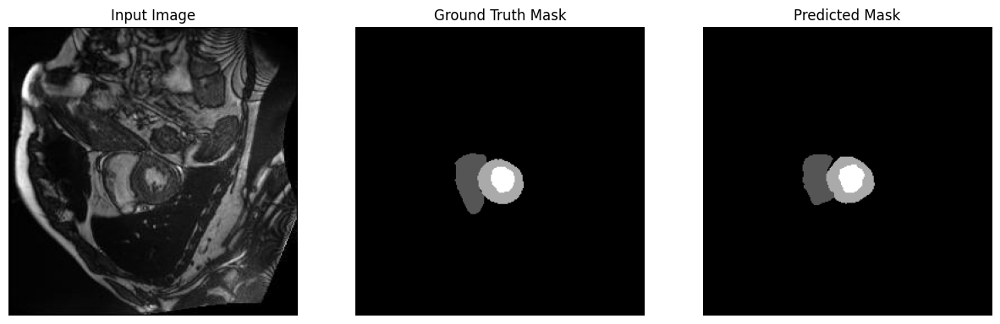

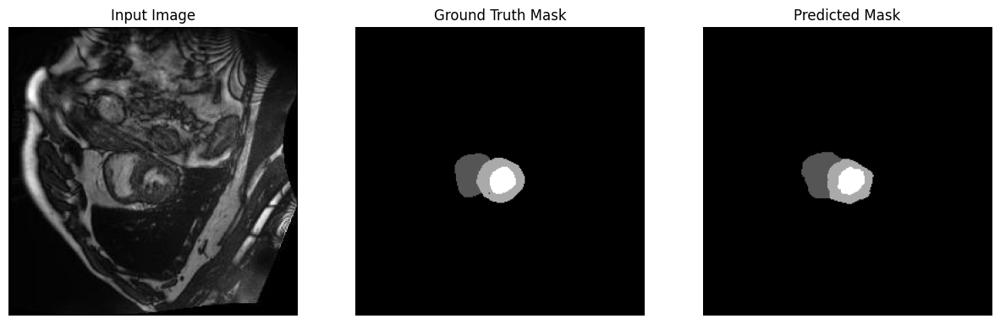

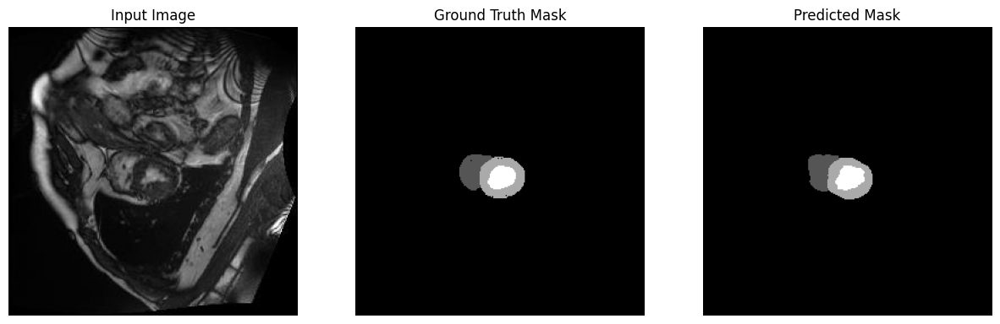

...

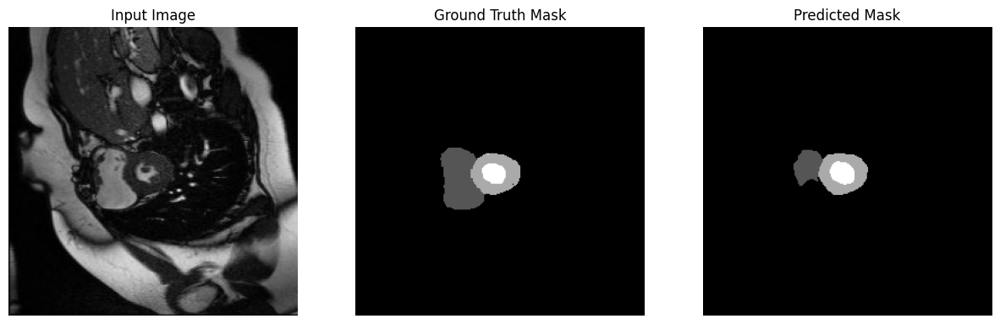

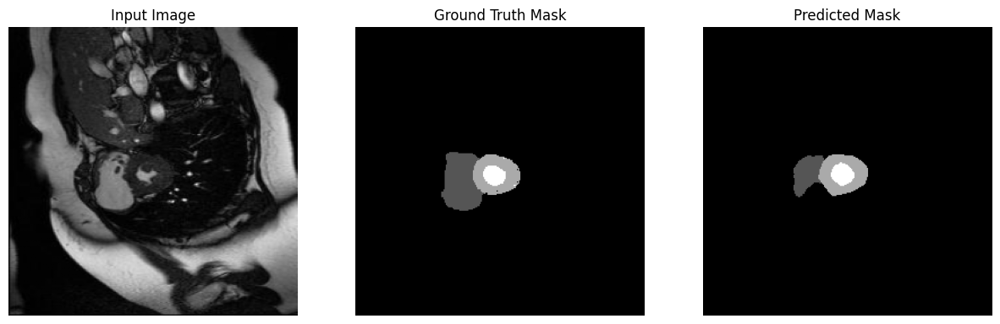

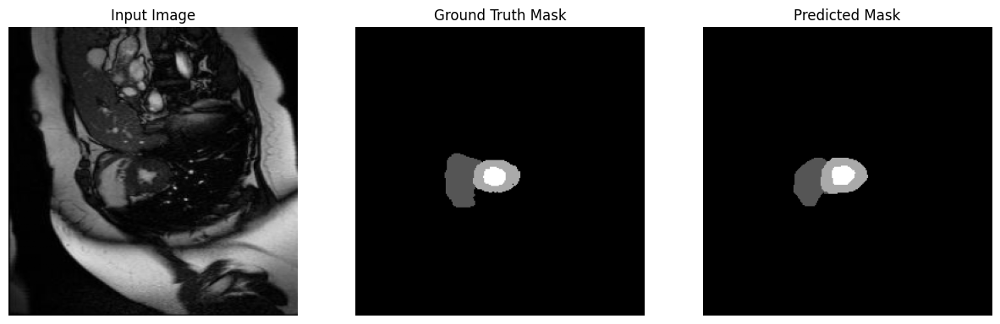

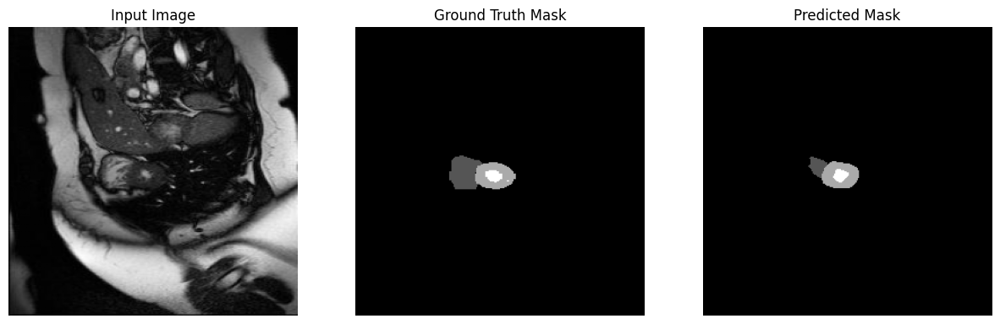

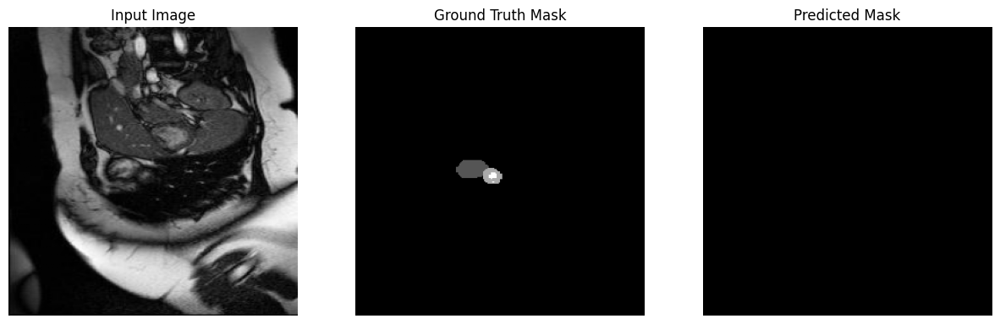

In [12]:
# %%
def visualize_predictions(model, X_test, mask_filenames, target_size=(256, 256)):
    predictions = model.predict(X_test)

    for i in range(len(X_test)):
        img = X_test[i]
        mask_path = mask_filenames[i]
        ground_truth = cv2.imread(mask_path, cv2.IMREAD_GRAYSCALE)
        if ground_truth is None:
            print(f"Warning: Unable to read mask {mask_path}. Skipping visualization.")
            continue
        ground_truth = remap_mask_with_ranges(ground_truth)
        ground_truth = cv2.resize(ground_truth, target_size, interpolation=cv2.INTER_NEAREST)
        predicted_mask = np.argmax(predictions[i], axis=-1)

        plt.figure(figsize=(15, 5))

        plt.subplot(1, 3, 1)
        plt.title("Input Image")
        plt.imshow(img)
        plt.axis("off")

        plt.subplot(1, 3, 2)
        plt.title("Ground Truth Mask")
        plt.imshow(ground_truth, cmap="gray")
        plt.axis("off")

        plt.subplot(1, 3, 3)
        plt.title("Predicted Mask")
        plt.imshow(predicted_mask, cmap="gray")
        plt.axis("off")

        plt.show()

# Contoh memanggil visualisasi
visualize_predictions(unet_model, X_test, mask_filenames_test)
